<a href="https://colab.research.google.com/github/vlozg/aicovid/blob/main/%5BExplore001%5D_AICOVID_115M.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Notebook này nhằm mục đích trực quan và khám phả, thử các bước tiền xử lý.

# Detect COVID-19 patients via forced-cough cell phone recording

- **Bài toán**: Nhận diện người nhiễm COVID-19 qua tiếng ho ép buộc
    - **Input**: Đoạn ghi âm tiếng ho, tuổi và giới tính
    - **Output**: Phân loại người nhiễm bệnh hay không

## Tìm hiểu bài toán 
Qua paper (https://dspace.mit.edu/bitstream/handle/1721.1/128954/09208795.pdf?sequence=1&isAllowed=y)

# Các biến thiết lập cho thử nghiệm

In [ ]:
val_split = 0.8

In [ ]:
forced_sr = 8000 # -1 mean not enforced
n_mfcc_ceptrum = 24
n_delta_features = 1
n_mfcc_features = n_mfcc_ceptrum * (1+n_delta_features)
n_mfcc_features

48

# Import và cài đặt thư viện

In [ ]:
# cài lib. note: cài xong phải restart runtime
try:
  import torchaudio
except ImportError:
  !pip install torchaudio

In [ ]:
# Quản lý file, folder
import os

# Xử lý audio
import librosa

# Hiện audio nghe thử
import IPython.display as ipd
from IPython.display import Audio, display

from tqdm import tqdm

import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader

import torchaudio
from torchvision.models import resnet50

# Tải dữ liệu

In [ ]:
#@markdown Tải dữ liệu
%%capture
# download public train data
# official link: https://drive.google.com/file/d/1MPhz3zYl2yefCq-J5XySbFJt99BfKIZD/view
# personal link: https://drive.google.com/file/d/1hoGLxjLmPY-pX-jSVGIaWIZhovQBMKU1/view?usp=sharing
if not os.path.isfile('./aicv115m_public_train.zip'):
  !gdown --id 1MPhz3zYl2yefCq-J5XySbFJt99BfKIZD
  !unzip -o aicv115m_public_train.zip

# dowload public test data
# official link: https://drive.google.com/file/d/1UrMudzopA3CyR1Ih2J63Kfi2mY_0uhRK/view
# personal link: https://drive.google.com/file/d/1X7vOjHos9f9w48-iTWyu5JElFqCjcH_R/view?usp=sharing
if not os.path.isfile('./aicv115m_public_test.zip'):
  !gdown --id 1UrMudzopA3CyR1Ih2J63Kfi2mY_0uhRK
  !unzip -o aicv115m_public_test.zip

In [ ]:
#@markdown Tải noise audio
import requests

!mkdir _sample_data
SAMPLE_NOISE_URL = "https://pytorch-tutorial-assets.s3.amazonaws.com/VOiCES_devkit/distant-16k/distractors/rm1/babb/Lab41-SRI-VOiCES-rm1-babb-mc01-stu-clo.wav"
SAMPLE_NOISE_PATH = os.path.join('_sample_data', "bg.wav")
SAMPLE_RIR_URL = "https://pytorch-tutorial-assets.s3.amazonaws.com/VOiCES_devkit/distant-16k/room-response/rm1/impulse/Lab41-SRI-VOiCES-rm1-impulse-mc01-stu-clo.wav"
SAMPLE_RIR_PATH = os.path.join('_sample_data', "rir.wav")

def _fetch_data():
  uri = [
    (SAMPLE_NOISE_URL, SAMPLE_NOISE_PATH),
    (SAMPLE_RIR_URL, SAMPLE_RIR_PATH)
  ]
  for url, path in uri:
    with open(path, 'wb') as file_:
      file_.write(requests.get(url).content)

_fetch_data()

mkdir: cannot create directory ‘_sample_data’: File exists


# Setup thư mục chứa data và đọc meta

In [ ]:
#@markdown Giải nén data
%%capture
!unzip -n aicv115m_public_train/train_audio_files_8k.zip
!unzip -n aicv115m_public_test/public_test_audio_files_8k.zip

train_path = 'train_audio_files_8k/'
test_path = 'public_test_audio_files_8k/'

In [ ]:
print(f'Train path: {train_path}')
print(f'Test path: {test_path}')

Train path: train_audio_files_8k/
Test path: public_test_audio_files_8k/


In [ ]:
#@markdown Đọc meta
train_meta = pd.read_csv('aicv115m_public_train/metadata_train_challenge.csv')
train_meta['file_path'] = train_path+train_meta['file_path']
test_meta = pd.read_csv('aicv115m_public_test/metadata_public_test.csv')
test_meta['file_path'] = test_path+test_meta['file_path']

In [ ]:
display(train_meta.shape)
train_meta.head()

(1199, 5)

,uuid,subject_gender,subject_age,assessment_result,file_path
0,3284bcf1-2446-4f3a-ac66-14c76b294177,male,23.0,0,train_audio_files_8k/3284bcf1-2446-4f3a-ac66-1...
1,431334e1-5946-4576-bb51-8e342ccc22b4,NaN,NaN,0,train_audio_files_8k/431334e1-5946-4576-bb51-8...
2,1d6fac4b-1e7f-4bdc-81cd-3a720bfbb1e1,NaN,NaN,0,train_audio_files_8k/1d6fac4b-1e7f-4bdc-81cd-3...
3,c7ee0695-b2e7-4beb-b904-f1455c9609d9,male,49.0,0,train_audio_files_8k/c7ee0695-b2e7-4beb-b904-f...
4,dd541704-b696-4181-8fd8-816daac0fcf9,NaN,NaN,0,train_audio_files_8k/dd541704-b696-4181-8fd8-8...


In [ ]:
display(test_meta.shape)
test_meta.head()

(350, 4)

,uuid,subject_gender,subject_age,file_path
0,66ef1f05-fbb0-44cb-8bdb-8eb4df83359a,female,28.0,public_test_audio_files_8k/66ef1f05-fbb0-44cb-...
1,73d13a12-f9bc-4554-af49-be24f6024a25,NaN,NaN,public_test_audio_files_8k/73d13a12-f9bc-4554-...
2,d27dbe98-e061-4018-9900-d1f1d47feab1,NaN,NaN,public_test_audio_files_8k/d27dbe98-e061-4018-...
3,43c30e4c-5d35-4ebc-8235-8920b7688550,female,NaN,public_test_audio_files_8k/43c30e4c-5d35-4ebc-...
4,1952aa84-d077-495d-a1a9-9686a30722e0,female,NaN,public_test_audio_files_8k/1952aa84-d077-495d-...


# Hàm xử lý âm thanh

Các hàm vỏ bọc cho đọc file

In [ ]:
'''
  Read audio from given path and return (wave, sample_rate)
'''
def read_audio(full_audio_path):
  return torchaudio.load(full_audio_path)

'''
  Read audio from given path, then resample if sample rate is not matched 
  and return wave.

  Tips: 
    you should provide resampler from torchaudio.transform
    when batch resampling with same params since this can
    give a huge speed up.
'''
def read_resample_audio(
    full_audio_path, resample,
    resampler=None
):
  wave, sr = torchaudio.load(full_audio_path)
  if resampler is not None:
      wave = resampler(wave)
  elif sr != resample:
      wave = torchaudio.functional.resample(wave, sr, resample)
  return wave

Mel features

In [ ]:
# Spectrogram transformation
n_fft = 2048
win_length = 160
hop_length = 80
n_mels = 200
n_mfcc = 200

mfcc_transform = torchaudio.transforms.MFCC(
    sample_rate=8000,
    n_mfcc=n_mfcc,
    log_mels=True,
    melkwargs={
      'n_fft': n_fft,
      'n_mels': n_mels,
      'hop_length': hop_length,
      'win_length': win_length,
      #'norm': 'slaney',
      'normalized': True,
      'mel_scale': 'htk'
    }
)

spectrogram = torchaudio.transforms.Spectrogram(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
    center=True,
    normalized=True,
    pad_mode="reflect",
    power=2.0,
)

mel_spectrogram = torchaudio.transforms.MelSpectrogram(
    sample_rate=8000,
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
    center=True,
    pad_mode="reflect",
    power=2.0,
    #norm='slaney',
    onesided=True,
    normalized=True,
    n_mels=n_mels,
    mel_scale="htk",
)

delta_transform = torchaudio.transforms.ComputeDeltas(
    win_length = 5, 
    mode = 'replicate'
)

# Khám phá dữ liệu

## Khám phá thiếu

In [ ]:
train_meta.isna().sum()/train_meta.shape[0]

uuid                 0.000000
subject_gender       0.423686
subject_age          0.461218
assessment_result    0.000000
file_path            0.000000
dtype: float64

In [ ]:
test_meta.isna().sum()/test_meta.shape[0]

uuid              0.000000
subject_gender    0.271429
subject_age       0.300000
file_path         0.000000
dtype: float64

## Khám phá phân lớp

In [ ]:
train_meta['assessment_result'].value_counts()

0    737
1    462
Name: assessment_result, dtype: int64

# Các hàm bổ trợ trực quan

In [ ]:
[width, height] = matplotlib.rcParams['figure.figsize']
if width < 10:
  matplotlib.rcParams['figure.figsize'] = [width * 2.5, height]

In [ ]:
#@markdown Vẽ specgram (specgram chỉ đơn giản là apply discrete-time Fourier transform)
#@markdown `plot_specgram(wave, sr, title, xlim, ylim)`
def plot_specgram(waveform, sample_rate, title="Spectrogram", xlim=None):
  # Tensor --> Numpy
  waveform = waveform.numpy()

  num_channels, num_frames = waveform.shape
  time_axis = torch.arange(0, num_frames) / sample_rate

  figure, axes = plt.subplots(num_channels, 1)
  if num_channels == 1:
    axes = [axes]

  # Plot specgram for each channel
  for c in range(num_channels):
    axes[c].specgram(waveform[c], Fs=sample_rate)
    if num_channels > 1:
      axes[c].set_ylabel(f'Channel {c+1}')
    if xlim:
      axes[c].set_xlim(xlim)
  figure.suptitle(title)
  plt.show(block=False)

In [ ]:
#@markdown Vẽ waveform `plot_waveform(wave, sr, title, xlim, ylim)`
def plot_waveform(waveform, sample_rate, title="Waveform", xlim=None, ylim=None):
  # Tensor --> Numpy
  waveform = waveform.numpy()

  num_channels, num_frames = waveform.shape
  time_axis = torch.arange(0, num_frames) / sample_rate

  figure, axes = plt.subplots(num_channels, 1)
  if num_channels == 1:
    axes = [axes]

  # Plot waveform for each channel
  for c in range(num_channels):
    axes[c].plot(time_axis, waveform[c], linewidth=1)
    axes[c].grid(True)
    if num_channels > 1:
      axes[c].set_ylabel(f'Channel {c+1}')
    if xlim:
      axes[c].set_xlim(xlim)
    if ylim:
      axes[c].set_ylim(ylim)
  figure.suptitle(title)
  plt.show(block=False)

In [ ]:
#@markdown Vẽ spectrogram `plot_spectrogram(spec, axs, title, ylabel, aspect, xmax)`
def plot_spectrogram(spec, fig=None, axs=None, title=None, ylabel='freq_bin', aspect='auto', xmax=None):
  if axs is None:
    fig, axs = plt.subplots(1, 1)
  axs.set_title(title or 'Spectrogram (db)')
  axs.set_ylabel(ylabel)
  axs.set_xlabel('frame')
  im = axs.imshow(librosa.power_to_db(spec), origin='lower', aspect=aspect)
  if xmax:
    axs.set_xlim((0, xmax))
  fig.colorbar(im, ax=axs)

In [ ]:
#@markdown Hiển thị audio box `play_audio(wave, sr)`
def play_audio(waveform, sample_rate):
  waveform = waveform.numpy()

  num_channels, num_frames = waveform.shape
  if num_channels == 1:
    display(Audio(waveform[0], rate=sample_rate))
  elif num_channels == 2:
    display(Audio((waveform[0], waveform[1]), rate=sample_rate))
  else:
    raise ValueError("Waveform with more than 2 channels are not supported.")

Hàm lấy mẫu data random

In [ ]:
def _get_sample(path, resample=None):
  effects = [
    ["remix", "1"]
  ]
  if resample:
    effects.extend([
      ["lowpass", f"{resample // 2}"],
      ["rate", f'{resample}'],
    ])
  return torchaudio.sox_effects.apply_effects_file(path, effects=effects)

def get_noise_sample(*, resample=None):
  return _get_sample(SAMPLE_NOISE_PATH, resample=resample)

def get_rir_sample(*, resample=None, processed=False):
  rir_raw, sample_rate = _get_sample(SAMPLE_RIR_PATH, resample=resample)
  if not processed:
    return rir_raw, sample_rate
  rir = rir_raw[:, int(sample_rate*1.01):int(sample_rate*1.3)]
  rir = rir / torch.norm(rir, p=2)
  rir = torch.flip(rir, [1])
  return rir, sample_rate

In [ ]:
import random
def get_covid_samples(n_samples):
  df = train_meta[train_meta['assessment_result'] == 1]
  idxs = random.sample(range(len(df)), n_samples)
  return df.iloc[idxs]

def get_nocovid_samples(n_samples):
  df = train_meta[train_meta['assessment_result'] == 0]
  idxs = random.sample(range(len(df)), n_samples)
  return df.iloc[idxs]

# Khám phá âm thanh

In [ ]:
n_samples = 3

In [ ]:
#@markdown Đọc `n_samples` mẫu audio cho mỗi class
sample_noCOVID_files = get_nocovid_samples(n_samples)['file_path']
sample_COVID_files = get_covid_samples(n_samples)['file_path']

sample_noCOVIDs = []
sample_COVIDs = []

for file in sample_noCOVID_files:
  wave, sr = read_audio(file)
  sample_noCOVIDs.append({'wave': wave, 'sr': sr})

for file in sample_COVID_files:
  wave, sr = read_audio(file)
  sample_COVIDs.append({'wave': wave, 'sr': sr})

Sample 0:


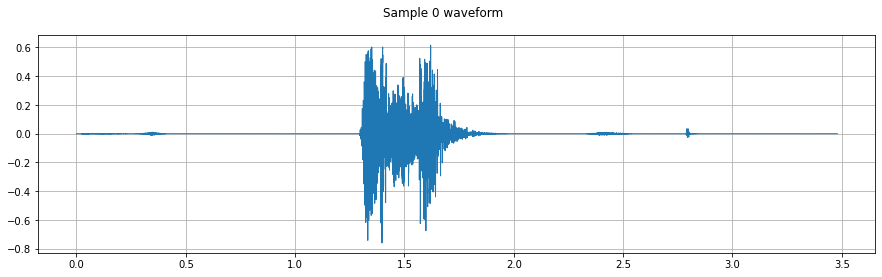

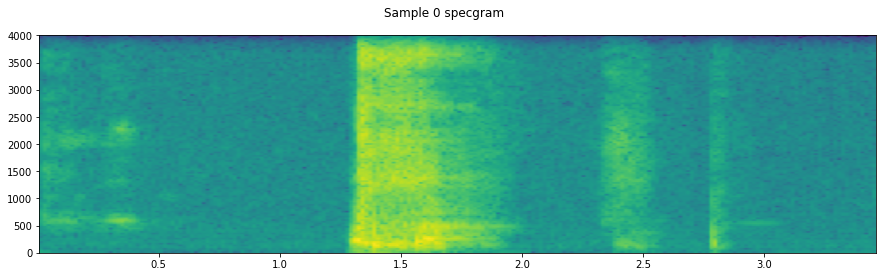

Sample 1:


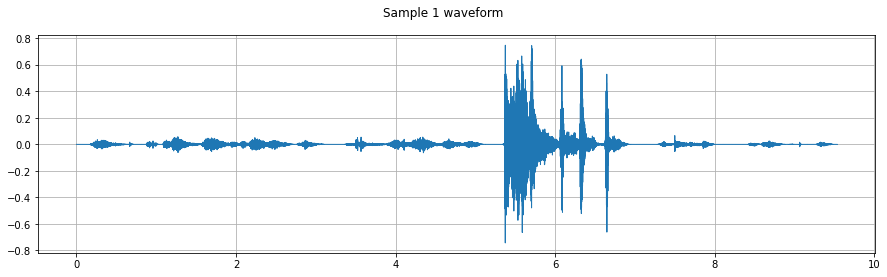

/usr/local/lib/python3.7/dist-packages/matplotlib/axes/_axes.py:7592: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


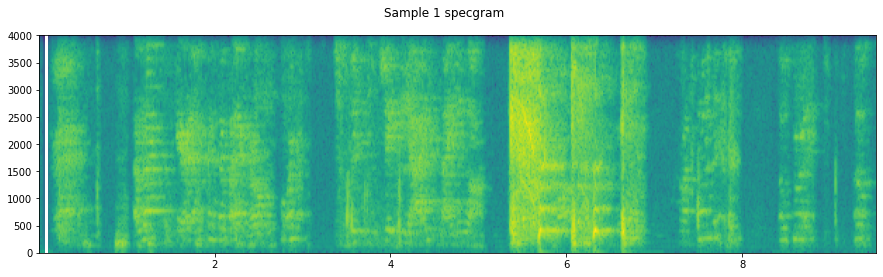

Sample 2:


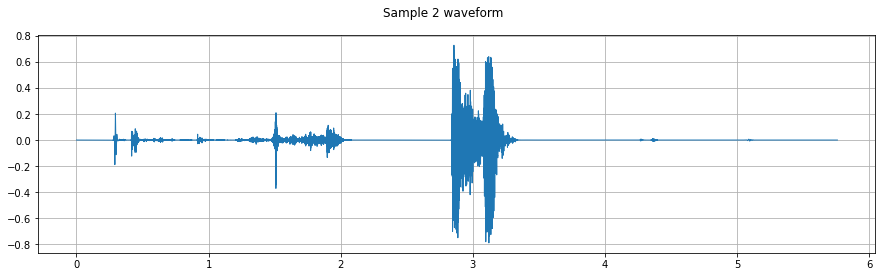

/usr/local/lib/python3.7/dist-packages/matplotlib/axes/_axes.py:7592: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


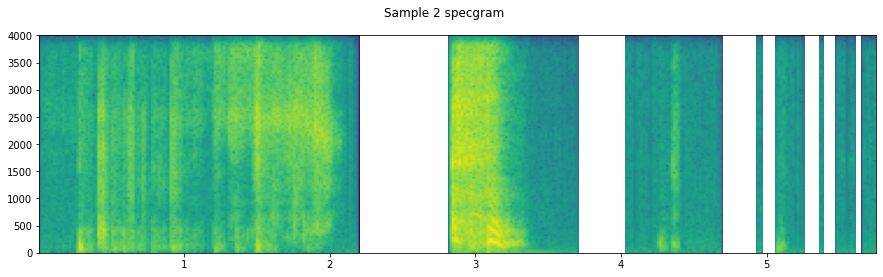

In [ ]:
#@markdown ## Các mẫu audio không COVID
for idx, a in enumerate(sample_noCOVIDs):
  print(f'Sample {idx}:')
  play_audio(a['wave'], a['sr'])
  plot_waveform(a['wave'], a['sr'], title=f'Sample {idx} waveform')
  plot_specgram(a['wave'], a['sr'], title=f'Sample {idx} specgram')

Sample 0:


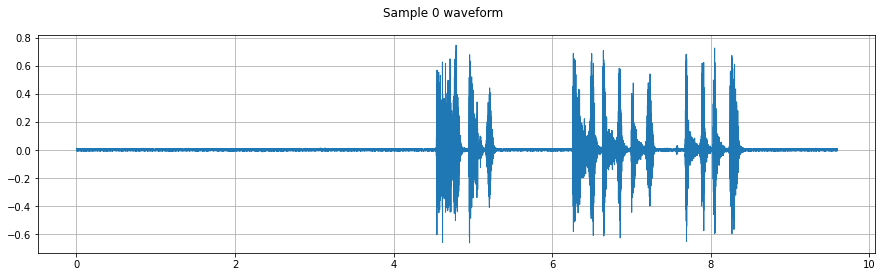

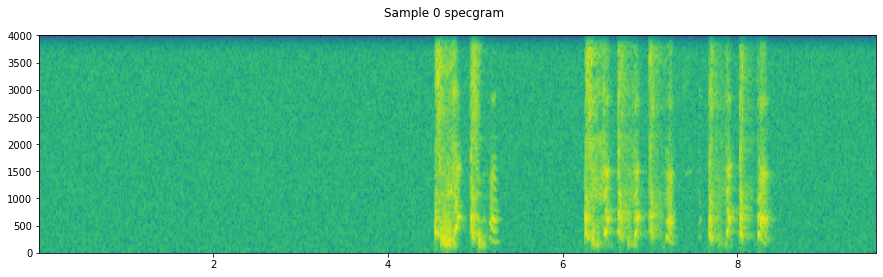

Sample 1:


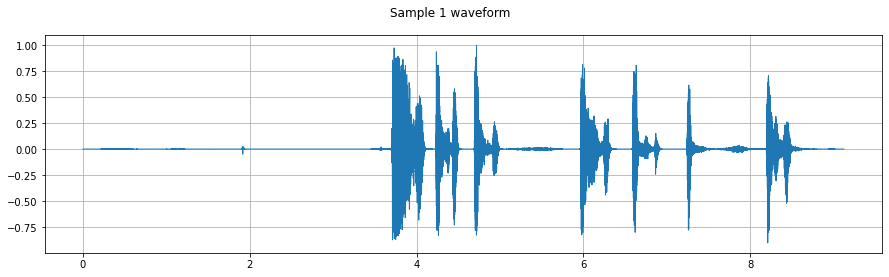

/usr/local/lib/python3.7/dist-packages/matplotlib/axes/_axes.py:7592: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


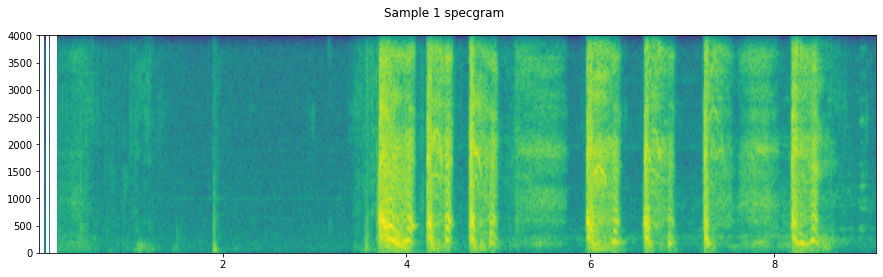

Sample 2:


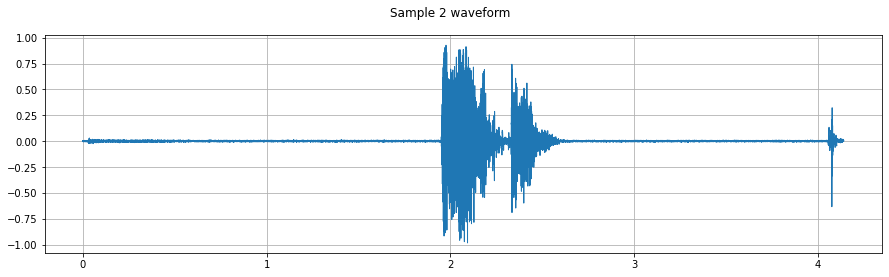

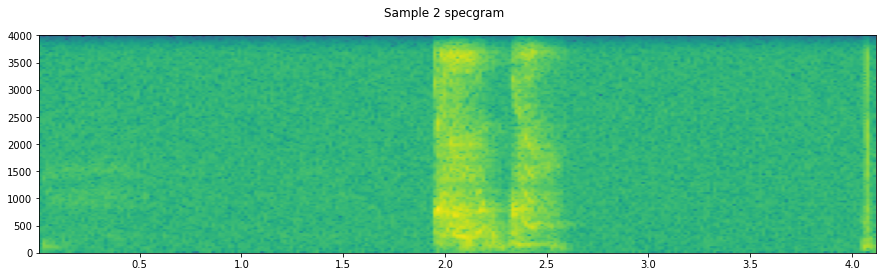

In [ ]:
#@markdown ## Các mẫu audio có COVID
for idx, a in enumerate(sample_COVIDs):
  print(f'Sample {idx}:')
  play_audio(a['wave'], a['sr'])
  plot_waveform(a['wave'], a['sr'], title=f'Sample {idx} waveform')
  plot_specgram(a['wave'], a['sr'], title=f'Sample {idx} specgram')

torch.Size([1, 1025, 349])
torch.Size([1, 1025, 955])
torch.Size([1, 1025, 577])
torch.Size([1, 1025, 961])
torch.Size([1, 1025, 913])
torch.Size([1, 1025, 415])


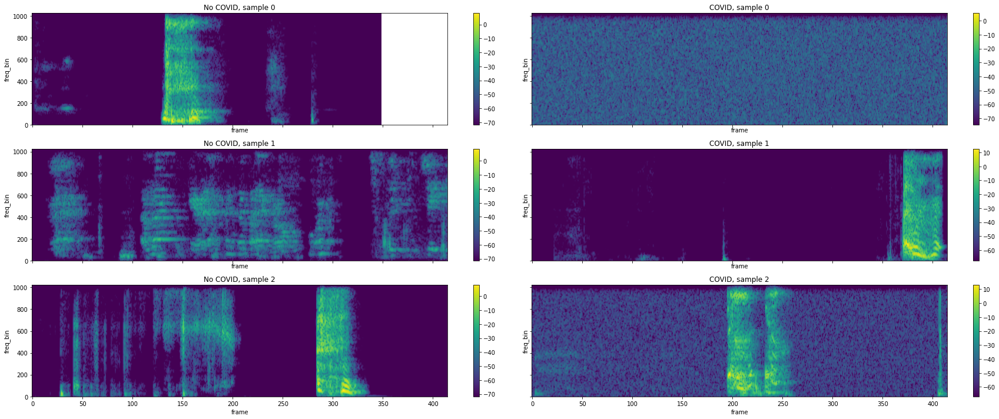

In [ ]:
#@markdown ## So sánh spectrogram
fig, axs = plt.subplots(nrows=n_samples, ncols=2, sharey='all', sharex='all')
fig.set_size_inches(25, 10)
for i, sample in enumerate(sample_noCOVIDs):
  spec = spectrogram(sample['wave'])
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][0], f'No COVID, sample {i}')
for i, sample in enumerate(sample_COVIDs):
  spec = spectrogram(sample['wave'])
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][1], f'COVID, sample {i}')
fig.tight_layout()
fig.show()

torch.Size([1, 200, 349])
torch.Size([1, 200, 955])
torch.Size([1, 200, 577])
torch.Size([1, 200, 961])
torch.Size([1, 200, 913])
torch.Size([1, 200, 415])


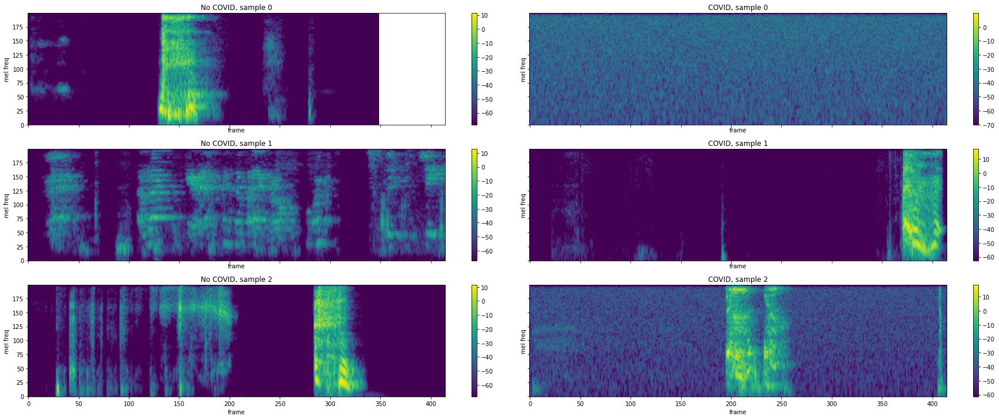

In [ ]:
#@markdown ## So sánh mel spectrogram
fig, axs = plt.subplots(nrows=n_samples, ncols=2, sharey='all', sharex='all')
fig.set_size_inches(25, 10)
for i, sample in enumerate(sample_noCOVIDs):
  spec = mel_spectrogram(sample['wave'])
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][0], f'No COVID, sample {i}', ylabel='mel freq')
for i, sample in enumerate(sample_COVIDs):
  spec = mel_spectrogram(sample['wave'])
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][1], f'COVID, sample {i}', ylabel='mel freq')
fig.tight_layout()
fig.show()

torch.Size([1, 200, 349])
torch.Size([1, 200, 955])
torch.Size([1, 200, 577])
torch.Size([1, 200, 961])
torch.Size([1, 200, 913])
torch.Size([1, 200, 415])


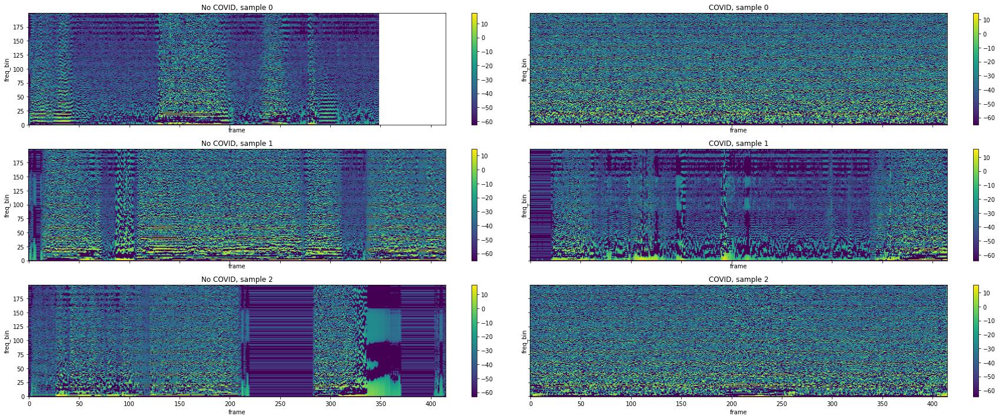

In [ ]:
#@markdown ## So sánh MFCC
fig, axs = plt.subplots(nrows=n_samples, ncols=2, sharey='all', sharex='all')
fig.set_size_inches(25, 10)
for i, sample in enumerate(sample_noCOVIDs):
  spec = mfcc_transform(sample['wave'])
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][0], f'No COVID, sample {i}')
for i, sample in enumerate(sample_COVIDs):
  spec = mfcc_transform(sample['wave'])
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][1], f'COVID, sample {i}')
fig.tight_layout()
fig.show()

torch.Size([1, 200, 349])
torch.Size([1, 200, 955])
torch.Size([1, 200, 577])
torch.Size([1, 200, 961])
torch.Size([1, 200, 913])
torch.Size([1, 200, 415])


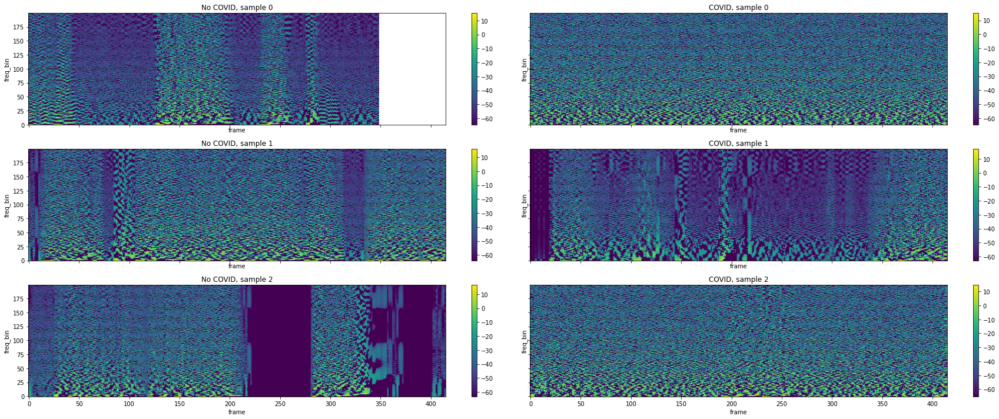

In [ ]:
#@markdown ## So sánh MFCC delta 1
fig, axs = plt.subplots(nrows=n_samples, ncols=2, sharey='all', sharex='all')
fig.set_size_inches(25, 10)
for i, sample in enumerate(sample_noCOVIDs):
  spec = delta_transform(mfcc_transform(sample['wave']))
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][0], f'No COVID, sample {i}')
for i, sample in enumerate(sample_COVIDs):
  spec = delta_transform(mfcc_transform(sample['wave']))
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][1], f'COVID, sample {i}')
fig.tight_layout()
fig.show()

torch.Size([1, 400, 349])
torch.Size([1, 400, 955])
torch.Size([1, 400, 577])
torch.Size([1, 400, 961])
torch.Size([1, 400, 913])
torch.Size([1, 400, 415])


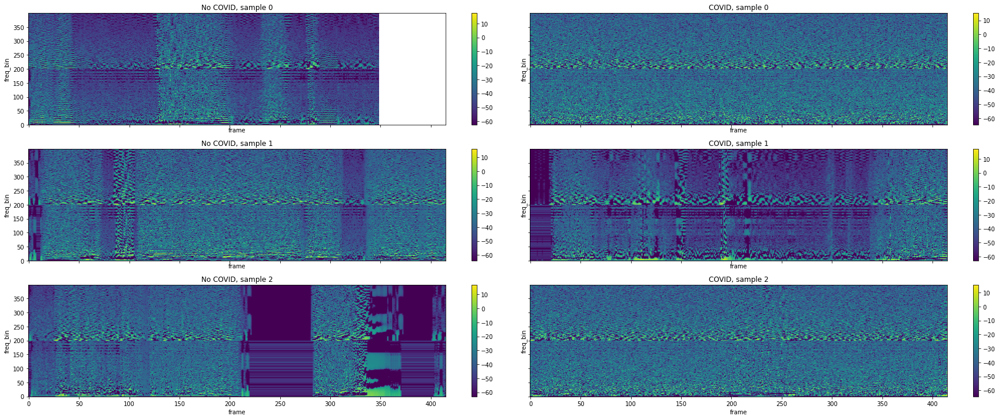

In [ ]:
#@markdown ## Concat MFCC và delta 1
fig, axs = plt.subplots(nrows=n_samples, ncols=2, sharey='all', sharex='all')
fig.set_size_inches(25, 10)
for i, sample in enumerate(sample_noCOVIDs):
  spec = mfcc_transform(sample['wave'])
  spec = torch.cat((spec, delta_transform(spec)), 1)
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][0], f'No COVID, sample {i}')
for i, sample in enumerate(sample_COVIDs):
  spec = mfcc_transform(sample['wave'])
  spec = torch.cat((spec, delta_transform(spec)), 1)
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][1], f'COVID, sample {i}')
fig.tight_layout()
fig.show()

## Lưu ý thêm
Trong paper ngta dùng python speech features, mà bây giờ lại thông dụng librosa, nên so so...

In [ ]:
%%capture
!pip install python-speech-features
from python_speech_features import mfcc

tensor([[-3.4155e+02, -3.2445e+02, -3.3108e+02,  ..., -3.2311e+02,
         -3.2534e+02, -3.2393e+02],
        [-1.8847e+01, -2.5583e+01, -2.6577e+01,  ..., -2.4259e+01,
         -2.4757e+01, -2.4396e+01],
        [-3.3512e+00, -5.7256e+00, -6.5642e+00,  ..., -1.1036e+01,
         -7.0497e+00, -5.5213e+00],
        ...,
        [ 4.7466e-02,  7.9717e-02, -1.4724e-01,  ...,  1.2893e-01,
         -8.8448e-02,  1.9103e-01],
        [-5.1222e-02, -2.5425e-02,  2.3682e-01,  ..., -1.7394e-01,
         -1.9556e-01,  1.5791e-01],
        [-7.5546e-03,  2.3458e-02, -2.0419e-01,  ...,  3.8921e-02,
         -1.2246e-01, -7.4863e-02]])

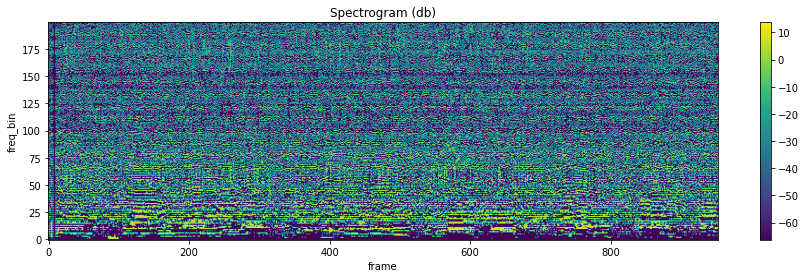

In [ ]:
mfcc_speechlib = lambda x: torch.Tensor([mfcc(signal=x.numpy()[0], samplerate=8000, winlen=0.02, winstep=0.01,
                                          numcep=200, nfilt=200, nfft=2048,
                                          ceplifter=0, appendEnergy=False, winfunc=np.hamming).T])
plot_spectrogram(mfcc_speechlib(sample_noCOVIDs[1]['wave'])[0])
torch.Tensor(mfcc_speechlib(sample_noCOVIDs[1]['wave'])[0])

torch.Size([1, 200, 347])
torch.Size([1, 200, 953])
torch.Size([1, 200, 575])
torch.Size([1, 200, 959])
torch.Size([1, 200, 911])
torch.Size([1, 200, 413])


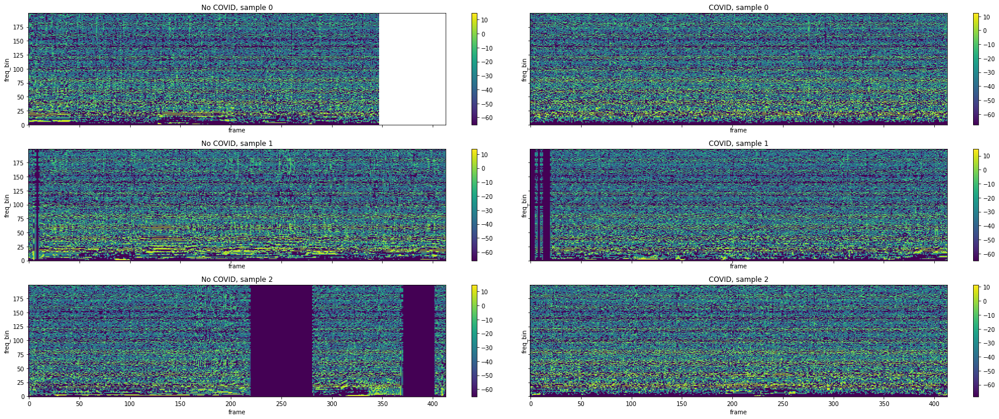

In [ ]:
#@markdown ## So sánh MFCC
fig, axs = plt.subplots(nrows=n_samples, ncols=2, sharey='all', sharex='all')
fig.set_size_inches(25, 10)
for i, sample in enumerate(sample_noCOVIDs):
  spec = mfcc_speechlib(sample['wave'])
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][0], f'No COVID, sample {i}')
for i, sample in enumerate(sample_COVIDs):
  spec = mfcc_speechlib(sample['wave'])
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][1], f'COVID, sample {i}')
fig.tight_layout()
fig.show()

torch.Size([1, 200, 347])
torch.Size([1, 200, 953])
torch.Size([1, 200, 575])
torch.Size([1, 200, 959])
torch.Size([1, 200, 911])
torch.Size([1, 200, 413])


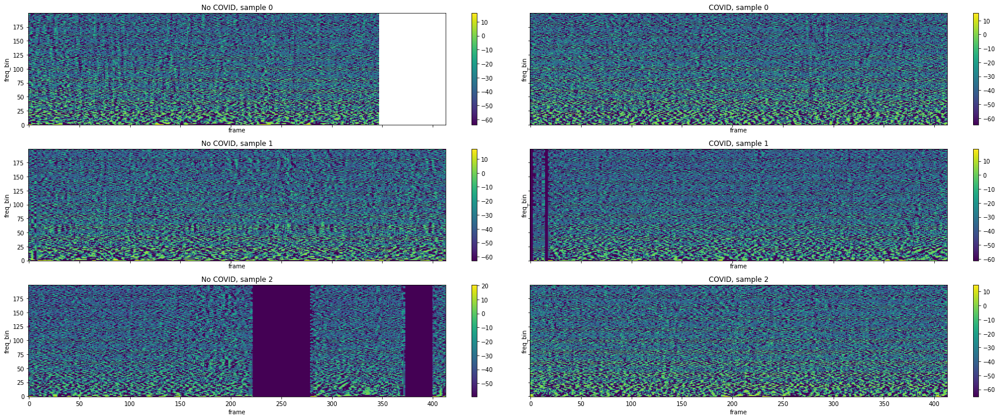

In [ ]:
#@markdown ## So sánh MFCC delta 1
fig, axs = plt.subplots(nrows=n_samples, ncols=2, sharey='all', sharex='all')
fig.set_size_inches(25, 10)
for i, sample in enumerate(sample_noCOVIDs):
  spec = delta_transform(mfcc_speechlib(sample['wave']))
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][0], f'No COVID, sample {i}')
for i, sample in enumerate(sample_COVIDs):
  spec = delta_transform(mfcc_speechlib(sample['wave']))
  print(spec.size())
  plot_spectrogram(spec[0], fig, axs[i][1], f'COVID, sample {i}')
fig.tight_layout()
fig.show()

# Làm giàu dữ liệu (augmentation)

## Chunking with overlap
Dữ liệu gốc thường chứa nhiều tiếng ho. Việc lấy ra các đoạn nhỏ giúp tăng kích thước dữ liệu lên rất nhiều, lại còn có thể đạt được kỹ thuật shifting miễn phí :v. Và cuối cùng là có thể đảm bảo dữ liệu đầu vào có kích thước giống nhau.

In [ ]:
spec = mfcc_transform(sample_noCOVIDs[2]['wave'])[0]
spec = (spec - spec.mean())/spec.std()
chunk_size = 300
chunk_step = 100
pad_size = chunk_size - spec.size()[1]%chunk_size
pad_size = (pad_size//2, pad_size//2+pad_size%2)
padded_spec = torch.nn.functional.pad(spec, pad_size, mode='constant', value=0)
chunks = padded_spec.unfold(1, chunk_size, chunk_step).permute(1,0,2)
chunks

tensor([[[ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ..., -1.1254e+01,
          -1.1286e+01, -1.1090e+01],
         [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ..., -1.6082e+00,
          -1.8179e+00, -1.1525e+00],
         [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  9.5339e-01,
           7.3240e-01,  1.3457e+00],
         ...,
         [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  5.7796e-02,
           6.5122e-02,  8.3360e-02],
         [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  7.8736e-02,
           7.7622e-02,  5.9675e-02],
         [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  6.6624e-02,
           6.4316e-02,  7.4626e-02]],

        [[-1.5107e+01, -1.5278e+01, -1.3485e+01,  ..., -2.7259e+00,
          -3.2188e+00, -3.1639e+00],
         [ 3.1223e-01,  1.0842e-01, -6.7953e-01,  ...,  5.8763e-01,
           4.6485e-01, -7.8440e-01],
         [ 2.6327e-01,  9.9306e-02, -6.3797e-01,  ..., -7.9092e-01,
          -3.2563e-01,  3.8930e-02],
         ...,
         [ 7.0373e-02,  7

In [ ]:
display(chunks.size())
display(chunks.max())
display(chunks.min())
display(chunks.mean())

torch.Size([5, 200, 200])

tensor(3.9631)

tensor(-15.3501)

tensor(0.0002)

In [ ]:
# Spectrogram vẽ ra có chuyển về db, vẽ từ spec gốc để biết được hệ số ngưỡng không âm
def plot_spectrogrammm(spec, fig=None, axs=None, title=None, ylabel='freq_bin', aspect='auto', xmax=None):
  if axs is None:
    fig, axs = plt.subplots(1, 1)
  axs.set_title(title or 'Spectrogram (db)')
  axs.set_ylabel(ylabel)
  axs.set_xlabel('frame')
  im = axs.imshow(spec, origin='lower', aspect=aspect)
  if xmax:
    axs.set_xlim((0, xmax))
  fig.colorbar(im, ax=axs)

0

tensor(3.1011)

tensor(-15.3501)

tensor(0.0024)

1

tensor(2.2267)

tensor(-15.3501)

tensor(-0.0008)

2

tensor(3.9631)

tensor(-15.3501)

tensor(0.0030)

3

tensor(3.9631)

tensor(-15.3501)

tensor(0.0020)

4

tensor(1.6633)

tensor(-15.3501)

tensor(-0.0054)

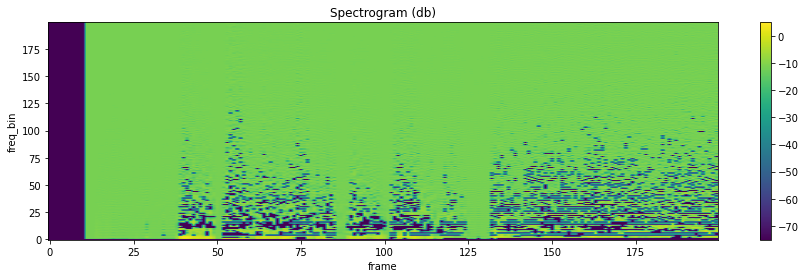

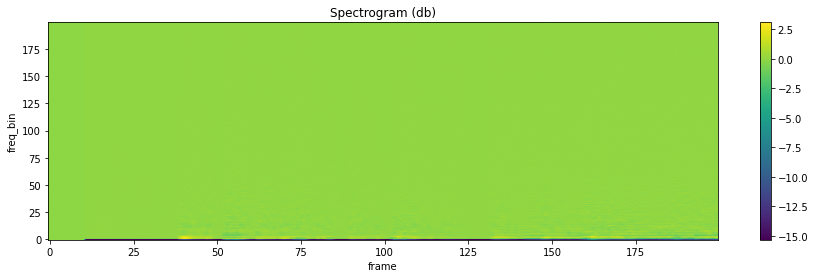

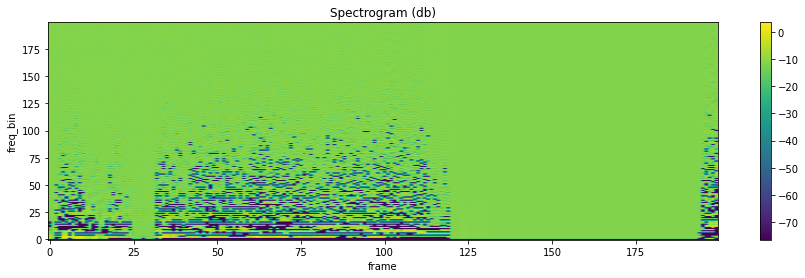

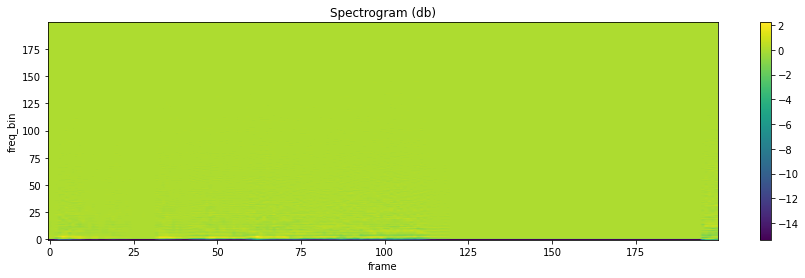

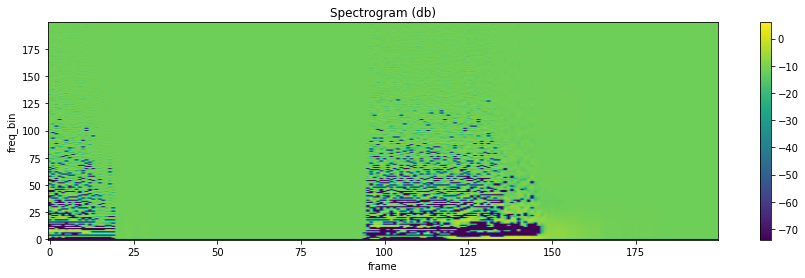

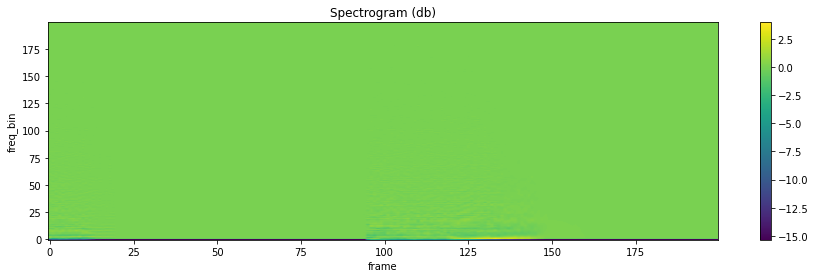

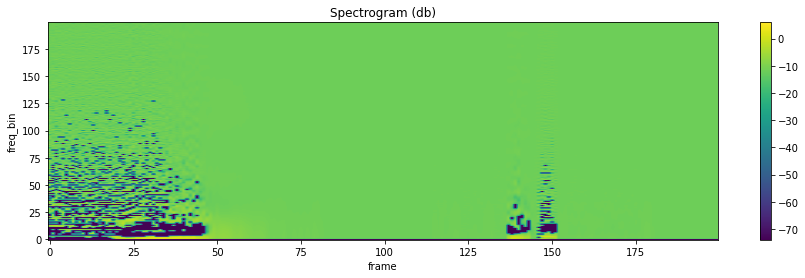

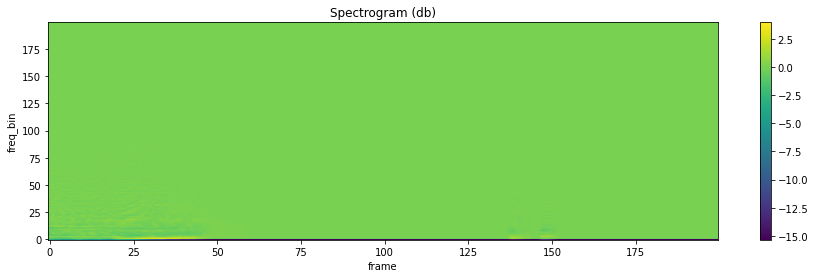

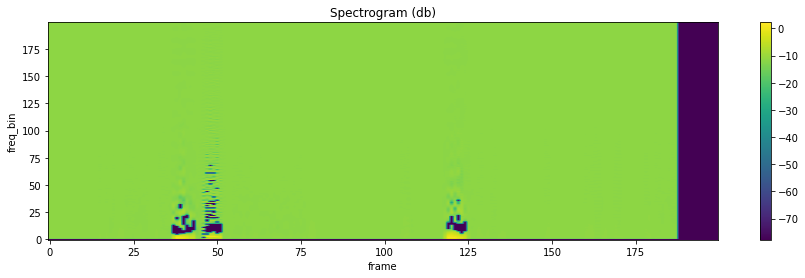

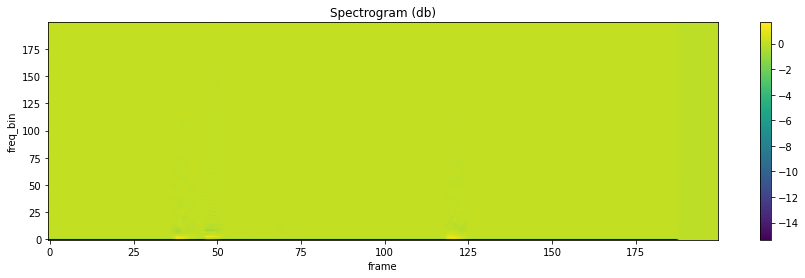

In [ ]:
for i in range(len(chunks)):
  display(i)
  display(chunks[i].max())
  display(chunks[i].min())
  display(chunks[i].mean())
  plot_spectrogram(chunks[i], f'Chunk {i}')
  plot_spectrogrammm(chunks[i], f'Chunk {i}')

Tuy nhiên dễ dàng nhận thấy sẽ xuất hiện một số đoạn không âm, khi này nếu đoạn này lọt vào class 1 thì thật thảm họa! Do đó cần chiến lược loại bỏ các chunk này trong class 1. Để đơn giản, mình sẽ loại đi chunks nào có max(MFCC_normed) < 1.7.

## Simulating a phone recoding
Source: https://pytorch.org/tutorials/beginner/audio_preprocessing_tutorial.html#simulating-a-phone-recoding

/usr/local/lib/python3.7/dist-packages/matplotlib/axes/_axes.py:7592: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


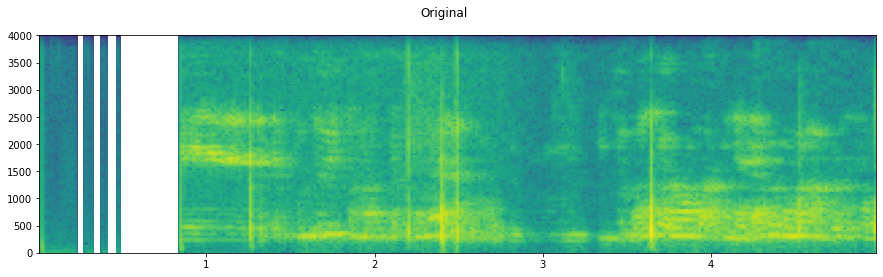

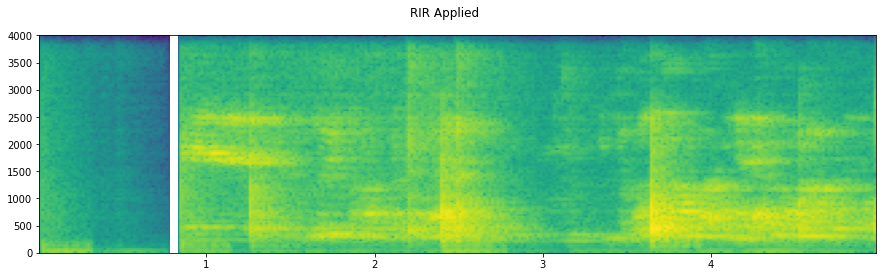

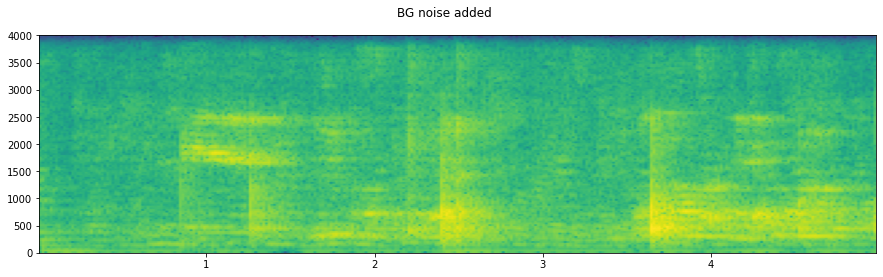

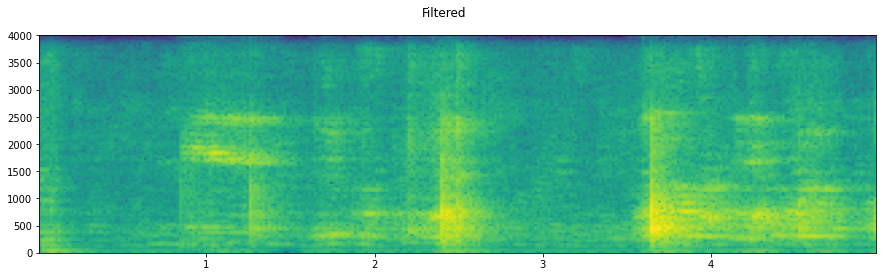

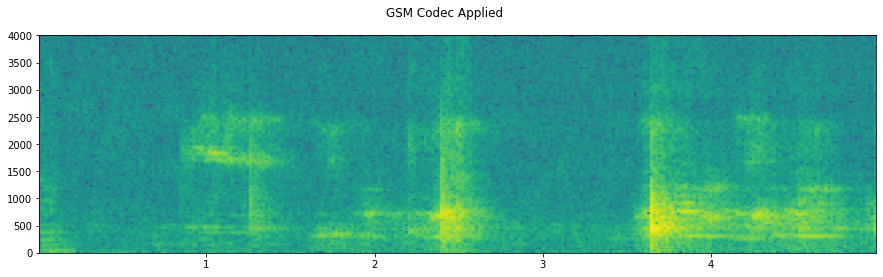

In [ ]:
import math

sample_rate = 8000
speech = sample_COVIDs[0]['wave'][:, :40000]

plot_specgram(speech, sample_rate, title="Original")
play_audio(speech, sample_rate)

# Apply RIR
rir, _ = get_rir_sample(resample=sample_rate, processed=True)
speech_ = torch.nn.functional.pad(speech, (rir.shape[1]-1, 0))
speech = torch.nn.functional.conv1d(speech_[None, ...], rir[None, ...])[0]

plot_specgram(speech, sample_rate, title="RIR Applied")
play_audio(speech, sample_rate)

# Add background noise
# Because the noise is recorded in the actual environment, we consider that
# the noise contains the acoustic feature of the environment. Therefore, we add
# the noise after RIR application.
noise, _ = get_noise_sample(resample=sample_rate)
noise = noise[:, :speech.shape[1]]

snr_db = 8
scale = math.exp(snr_db / 10) * noise.norm(p=2) / speech.norm(p=2)
speech = (scale * speech + noise/5) / 2

plot_specgram(speech, sample_rate, title="BG noise added")
play_audio(speech, sample_rate)

# Apply filtering and change sample rate
speech, sample_rate = torchaudio.sox_effects.apply_effects_tensor(
  speech,
  sample_rate,
  effects=[
      ["lowpass", "4000"],
      ["compand", "0.02,0.05", "-60,-60,-30,-10,-20,-8,-5,-8,-2,-8", "-8", "-7", "0.05"],
      ["rate", "8000"],
  ],
)

plot_specgram(speech, sample_rate, title="Filtered")
play_audio(speech, sample_rate)

# Apply telephony codec
speech = torchaudio.functional.apply_codec(speech, sample_rate, format="gsm")

plot_specgram(speech, sample_rate, title="GSM Codec Applied")
play_audio(speech, sample_rate)

# Đọc chuẩn bị dataset

In [ ]:
#@markdown OLD, không xài vì data ít, đọc lên GPU hẳn sẽ nhanh hơn
class AICOVIDDataset(Dataset):
    def __init__(self, meta_df, audio_transform=None, target_transform=None):
        try:
          self.labels = meta_df['assessment_result'].values
        except KeyError:
          self.labels = None
        self.file_dir = meta_df['file_path'].values
        self.ids = meta_df['uuid'].values
        self.genders = meta_df['subject_gender'].values
        self.ages = meta_df['subject_age'].values
        self.transform = audio_transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.file_dir)

    def __getitem__(self, idx):
        wave, _ = read_audio(self.file_dir[idx]) # Không lấy sample_rate
        label = torch.tensor(self.labels[idx]) if self.labels is not None else None
        id = self.ids[idx]
        gender = self.genders[idx]
        age = self.ages[idx]
        if self.transform:
            wave = self.transform(wave)
        if self.target_transform:
            label = self.target_transform(label)
        return wave, id, gender, age, label

In [ ]:
# Đọc hết toàn bộ train audio
MFCC_feats = []
labels = train_meta['assessment_result'].to_list()
max_len = 0
for file in train_meta['file_path']:
  wave = read_resample_audio(file, 8000)
  feat = mfcc_transform(wave)[0]
  feat = (feat - feat.mean())/feat.std()
  max_len = max(max_len, feat.size()[1])
  MFCC_feats.append(feat)

print(f"Maximum audio length in train set: {max_len}")

Maximum audio length in train set: 8899


Trường hợp đặc biệt: không mắc COVID nhưng ho như sắp chết tới nơi. May mà phân lớp người không bị nhiễm cũng thừa, trường hợp này mình có thể loại đi cho nhẹ hoặc tăng chunk step với phân lớp không mắc.

In [ ]:
play_audio(read_resample_audio(train_meta['file_path'].iloc[1140], 8000), 8000)

In [ ]:
for i, feat in enumerate(MFCC_feats):
  if feat.size()[1] > 1000:
    print(f"{i} - {feat.size()[1]}")

168 - 1003
217 - 1393
257 - 1003
297 - 1118
335 - 1009
349 - 1187
449 - 1003
461 - 1127
519 - 1076
522 - 1021
630 - 1127
667 - 1101
674 - 1349
688 - 1363
701 - 1981
710 - 1969
720 - 1993
723 - 1957
729 - 1969
731 - 1981
771 - 1003
778 - 1993
782 - 1369
795 - 1946
815 - 1969
828 - 1969
829 - 1741
875 - 1993
880 - 1957
885 - 1933
914 - 1981
938 - 1969
974 - 1993
1001 - 1993
1015 - 1861
1020 - 1400
1028 - 1633
1043 - 1285
1070 - 1945
1082 - 1969
1085 - 1957
1096 - 1249
1098 - 1110
1101 - 1933
1106 - 1993
1133 - 1003
1137 - 1151
1140 - 8899
1149 - 1969
1154 - 1993
1162 - 1489
1164 - 1945
1176 - 1801
1194 - 1993
1198 - 1993


Nhận xét: hầu hết đều không quá 21s, nên lấy max length là 21s. Riêng trường hợp trên thì để tránh lãng phí thì mình lấy chunk 21s. (lấy 21s vì chunk size là 300, step 200 thì sẽ chia đều)

In [ ]:
def pad_MFCC(feat, size=2000):
  pad_size = size - feat.size()[1]%size
  pad_size = (pad_size//2, pad_size//2+pad_size%2)
  padded = torch.nn.functional.pad(feat, pad_size, mode='constant', value=0)
  return padded

In [ ]:
# Loại bỏ special sample khỏi features và labels
special_sample = MFCC_feats.pop(1140)
special_sample_label = labels.pop(1140)

# Pad tất cả features còn lại
for i in range(len(MFCC_feats)):
  MFCC_feats[i] = pad_MFCC(MFCC_feats[i])

In [ ]:
# Chunking special sample and append back
for chunk in torch.chunk(special_sample, 5, 1):
  MFCC_feats.append(pad_MFCC(chunk))
  labels.append(special_sample_label)

Gom lại thành Dataset và chia tập

In [ ]:
full_train_set = torch.utils.data.TensorDataset(torch.stack(MFCC_feats).cuda(), torch.Tensor(labels).long().cuda())
split_shape = [round(len(labels)*val_split),  round(len(labels)*(1-val_split))]
train_set, test_set = torch.utils.data.random_split(full_train_set, split_shape)

In [ ]:
# TEST DATALOADER
train_set[0]

(tensor([[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0'),
 tensor(0, device='cuda:0'))

# Collate function

In [ ]:
def overlap_chunking(tensor, chunk_size, chunk_step):
  # Chunk_num x MFCC_features x chunk_size
  chunks = tensor.unfold(1, chunk_size, chunk_step).permute(1,0,2)
  return chunks[ torch.amax(chunks, dim=[1,2]) > 1.7 ]

def collate_fn(batch):
    # A data tuple has the form:
    # mfcc, label

    tensors, targets = [], []

    # Gather in lists, and encode labels as indices
    for mfcc_feat, label in batch:
        if label == 1:
          chunks = overlap_chunking(mfcc_feat, 300, 100)
        else:
          chunks = overlap_chunking(mfcc_feat, 300, 200)
        tensors += [chunks]
        targets += [label]*chunks.size()[0]

    # Group the list of tensors into a batched tensor
    tensors = torch.cat(tensors).unsqueeze(1)
    try:
      targets = torch.stack(targets)
      return tensors, targets
    except:
      return tensors

In [ ]:
batch_size = 16

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
if device == "cuda":
    num_workers = 1
    pin_memory = True
else:
    num_workers = 0
    pin_memory = False

In [ ]:
train_loader = torch.utils.data.DataLoader(
    train_set,
    batch_size=batch_size,
    shuffle=True,
    collate_fn=collate_fn,
    num_workers=num_workers,
    pin_memory=pin_memory,
)
test_loader = torch.utils.data.DataLoader(
    test_set,
    batch_size=batch_size,
    shuffle=False,
    collate_fn=collate_fn,
    num_workers=num_workers,
    pin_memory=pin_memory,
)

# Benchmarking Dataloader

In [ ]:
%%time
s=0
for t in train_loader:
  s+= t.size()[0]
display(s)

0

CPU times: user 336 ms, sys: 3.86 ms, total: 340 ms
Wall time: 339 ms
